In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib.colors import Normalize
import matplotlib.cm as cm
from mpl_toolkits.mplot3d import Axes3D
import plotly.express as px
import plotly.figure_factory as ff
import time

In [2]:
node_metrics = pd.read_csv("data/node_metrics.csv", index_col=[0])
node_metrics

,cellid,mitoid,count,diams,nodedist,nodeid
0,648518346349539333,2718056,21,0.655340,26594.530396,17670
1,648518346349539333,2718056,38,0.929892,26869.960938,17708
2,648518346349539333,2718056,22,0.853151,27009.407959,17725
3,648518346349539333,2718056,24,0.748397,26464.676453,17653
4,648518346349539333,2718056,18,0.585603,25934.409683,17576
...,...,...,...,...,...,...
3684332,648518346349538298,1911448,21,1.085070,4941.646362,8327
3684333,648518346349538298,1911448,7,1.143378,4779.511353,8324
3684334,648518346349538298,1911448,12,2.120830,10383.978722,8333
3684335,648518346349538298,1911448,20,1.705424,8208.868919,8526


In [3]:
# make cellid_str and mitoid_str columns for plotly purposes

node_metrics['cellid_str'] = node_metrics['cellid'].astype(str)
node_metrics['mitoid_str'] = node_metrics['mitoid'].astype(str)
node_metrics

,cellid,mitoid,count,diams,nodedist,nodeid,cellid_str,mitoid_str
0,648518346349539333,2718056,21,0.655340,26594.530396,17670,648518346349539333,2718056
1,648518346349539333,2718056,38,0.929892,26869.960938,17708,648518346349539333,2718056
2,648518346349539333,2718056,22,0.853151,27009.407959,17725,648518346349539333,2718056
3,648518346349539333,2718056,24,0.748397,26464.676453,17653,648518346349539333,2718056
4,648518346349539333,2718056,18,0.585603,25934.409683,17576,648518346349539333,2718056
...,...,...,...,...,...,...,...,...
3684332,648518346349538298,1911448,21,1.085070,4941.646362,8327,648518346349538298,1911448
3684333,648518346349538298,1911448,7,1.143378,4779.511353,8324,648518346349538298,1911448
3684334,648518346349538298,1911448,12,2.120830,10383.978722,8333,648518346349538298,1911448
3684335,648518346349538298,1911448,20,1.705424,8208.868919,8526,648518346349538298,1911448


In [4]:
# pull in sa, complexity and compartment so I can color by compartment

mito = pd.read_csv('data/pni_mito_cellswskel_v185_fullstats.csv')
mito

,mito_id,mito_vx,ctr_pos_x_vx,ctr_pos_y_vx,ctr_pos_z_vx,bbox_beg_x_vx,bbox_beg_y_vx,bbox_beg_z_vx,bbox_end_x_vx,bbox_end_y_vx,bbox_end_z_vx,cellid,ctr_pos_x_nm,ctr_pos_y_nm,ctr_pos_z_nm,surface_area,complexityindex,compartment
0,1783325,527936,75186,43844,1430,74824,43668,1323,75472,44120,1561,648518346349523993,300744,175376,57200,6.187842,20.482515,Basal
1,3272360,354680,101562,47000,241,101260,46750,191,101750,47228,303,648518346349538711,406248,188000,9640,3.780227,10.346855,Apical
2,1776789,523452,74500,43210,1457,73444,42632,1401,75636,43732,1564,648518346349538102,298000,172840,58280,6.992364,30.063988,Apical
3,2158922,4428,81214,54992,1230,81172,54962,1228,81254,55018,1235,648518346349538730,324856,219968,49200,0.129240,2.652803,Apical
4,2158896,11196,81194,53124,2007,81142,53096,2004,81250,53168,2014,648518346349532295,324776,212496,80280,0.224896,2.186498,Axonal
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
210970,1302900,2116324,65836,40492,311,65132,40146,191,66430,40734,368,648518346349516055,263344,161968,12440,20.038195,43.285222,Unknown
210971,3189781,2193980,98800,58132,469,98240,57710,379,99286,58468,536,648518346349539215,395200,232528,18760,21.290737,48.309769,Unknown
210972,2657020,2453896,88816,68882,429,88220,68540,21,89432,69438,877,648518346349539376,355264,275528,17160,25.841965,69.054582,Basal
210973,1307970,2617596,66122,41208,293,65406,40902,173,66600,41576,356,648518346349516055,264488,164832,11720,27.147893,70.360888,Unknown


In [5]:
mito_merge = mito[['mito_id','surface_area', 'complexityindex', 'compartment']]
mito_merge

,mito_id,surface_area,complexityindex,compartment
0,1783325,6.187842,20.482515,Basal
1,3272360,3.780227,10.346855,Apical
2,1776789,6.992364,30.063988,Apical
3,2158922,0.129240,2.652803,Apical
4,2158896,0.224896,2.186498,Axonal
...,...,...,...,...
210970,1302900,20.038195,43.285222,Unknown
210971,3189781,21.290737,48.309769,Unknown
210972,2657020,25.841965,69.054582,Basal
210973,1307970,27.147893,70.360888,Unknown


In [6]:
node_metrics_merge = pd.merge(node_metrics, mito_merge, left_on='mitoid', right_on='mito_id', how='inner')
node_metrics_merge.drop(columns='mito_id', inplace=True)
node_metrics_merge

,cellid,mitoid,count,diams,nodedist,nodeid,cellid_str,mitoid_str,surface_area,complexityindex,compartment
0,648518346349539333,2718056,21,0.655340,26594.530396,17670,648518346349539333,2718056,6.903265,21.396764,Basal
1,648518346349539333,2718056,38,0.929892,26869.960938,17708,648518346349539333,2718056,6.903265,21.396764,Basal
2,648518346349539333,2718056,22,0.853151,27009.407959,17725,648518346349539333,2718056,6.903265,21.396764,Basal
3,648518346349539333,2718056,24,0.748397,26464.676453,17653,648518346349539333,2718056,6.903265,21.396764,Basal
4,648518346349539333,2718056,18,0.585603,25934.409683,17576,648518346349539333,2718056,6.903265,21.396764,Basal
...,...,...,...,...,...,...,...,...,...,...,...
3684332,648518346349538298,1911448,21,1.085070,4941.646362,8327,648518346349538298,1911448,5.679162,7.871268,Basal
3684333,648518346349538298,1911448,7,1.143378,4779.511353,8324,648518346349538298,1911448,5.679162,7.871268,Basal
3684334,648518346349538298,1911448,12,2.120830,10383.978722,8333,648518346349538298,1911448,5.679162,7.871268,Basal
3684335,648518346349538298,1911448,20,1.705424,8208.868919,8526,648518346349538298,1911448,5.679162,7.871268,Basal


In [7]:
# cellids in df
node_metrics_merge.cellid.value_counts()

648518346349538440    21029
648518346349539856    19364
648518346349539785    19106
648518346349538426    18641
648518346349540055    18539
                      ...  
648518346349537844     2116
648518346349522862     1369
648518346349493874     1356
648518346349493472      810
648518346349517132      554
Name: cellid, Length: 363, dtype: int64

In [8]:
len(node_metrics_merge.cellid.unique())

363

In [9]:
cellid_list = node_metrics_merge.cellid.unique()
cellid_list

array([648518346349539333, 648518346349539334, 648518346349523975,
       648518346349539336, 648518346349538312, 648518346349538317,
       648518346349523981, 648518346349537297, 648518346349539347,
       648518346349537300, 648518346349532180, 648518346349523993,
       648518346349538332, 648518346349539359, 648518346349535264,
       648518346349538336, 648518346349539366, 648518346349539368,
       648518346349533227, 648518346349539376, 648518346349537331,
       648518346349535286, 648518346349531192, 648518346349536312,
       648518346349538365, 648518346349539390, 648518346349538368,
       648518346349535300, 648518346349533252, 648518346349539401,
       648518346349538378, 648518346349534289, 648518346349533267,
       648518346349538387, 648518346349496405, 648518346349539414,
       648518346349523030, 648518346349534292, 648518346349538391,
       648518346349538395, 648518346349531230, 648518346349539423,
       648518346349524063, 648518346349536354, 648518346349537

In [10]:
len(node_metrics_merge.cellid.value_counts())

363

In [11]:
# mitoids in df
node_metrics_merge.mitoid.value_counts()

2130887    1345
648935     1291
786767     1159
682245     1095
2473233    1054
           ... 
3973045       1
3864234       1
3287281       1
4210714       1
1333138       1
Name: mitoid, Length: 183663, dtype: int64

In [90]:
mitocounts = node_metrics_merge.mitoid.value_counts()
mitocounts.value_counts()

1       40449
2       27980
3       14501
4        9381
5        7006
        ...  
514         1
513         1
512         1
511         1
1345        1
Name: mitoid, Length: 585, dtype: int64

In [12]:
node_metrics_merge.mitoid.value_counts().head(1000)

2130887    1345
648935     1291
786767     1159
682245     1095
2473233    1054
           ... 
1534008     271
2305519     270
1457360     270
2127963     270
2369507     270
Name: mitoid, Length: 1000, dtype: int64

In [13]:
len(node_metrics_merge.mitoid.value_counts())

183663

In [14]:
len(node_metrics_merge.nodeid.unique())

28004

In [15]:
# node ids in df
node_metrics_merge.nodeid.value_counts()

1704     404
6170     403
661      403
671      400
7793     391
        ... 
27957      1
27888      1
27960      1
27906      1
26341      1
Name: nodeid, Length: 28004, dtype: int64

In [16]:
len(node_metrics_merge.nodeid.value_counts())

28004

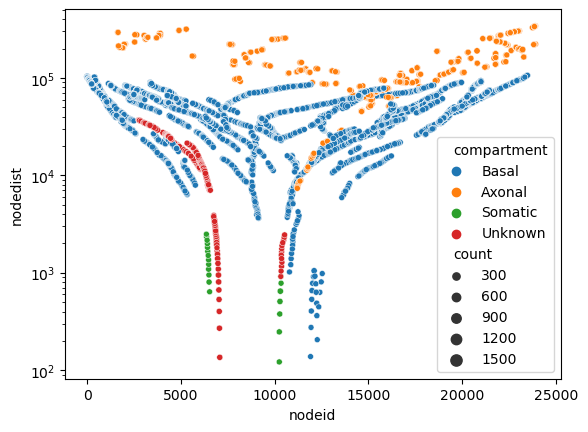

In [99]:
start_time = time.time()

indx = 0
querydf = node_metrics_merge[node_metrics_merge['cellid'] == cellid_list[indx]]
mitoid_list = querydf.mitoid.unique()

sns.scatterplot(querydf, x='nodeid', y='nodedist', hue='compartment', size='count', alpha=1, legend=True) 
plt.yscale('log')

In [18]:
elapsed_time = time.time() - start_time
print(f"Elapsed time: {elapsed_time:.3f} seconds")

Elapsed time: 0.988 seconds


In [19]:
# crashes
#fig = px.scatter_3d(querydf, x='nodeid', y='diams', z='nodedist', size='count')
#fig.show()

In [20]:
mitoid_list = querydf.mitoid.unique()
len(mitoid_list)

678

In [21]:
np.trunc(np.sqrt(len(mitoid_list)))

26.0

In [22]:
querydf.mitoid

0        2718056
1        2718056
2        2718056
3        2718056
4        2718056
          ...   
11188    2945980
11189    2945980
11190    2945980
11191    2945980
11192    2945980
Name: mitoid, Length: 11193, dtype: int64

In [23]:
print(cellid_list[indx])

648518346349539333


In [24]:
print(len(querydf.mitoid.unique()))

678


In [25]:
# info for the highest nodeid of 1704
nodeid_max = node_metrics_merge[node_metrics_merge.nodeid == 1704]
nodeid_max

,cellid,mitoid,count,diams,nodedist,nodeid,cellid_str,mitoid_str,surface_area,complexityindex,compartment
14586,648518346349539334,1613310,20,0.645058,92483.101837,1704,648518346349539334,1613310,33.968272,121.773919,Basal
28255,648518346349523975,1770239,23,0.362190,88778.920033,1704,648518346349523975,1770239,1.058693,8.478229,Basal
49755,648518346349538312,1247548,27,0.371305,99078.332966,1704,648518346349538312,1247548,12.962367,55.027940,Basal
53009,648518346349538317,1305042,26,0.879530,9958.624313,1704,648518346349538317,1305042,10.532662,63.112379,Basal
59119,648518346349523981,982562,17,0.749270,26471.300880,1704,648518346349523981,982562,1.809934,5.327219,Basal
...,...,...,...,...,...,...,...,...,...,...,...
3629201,648518346349524971,1189786,13,0.560927,62762.716637,1704,648518346349524971,1189786,14.719993,39.872353,Basal
3646000,648518346349538291,744069,20,0.561423,46940.366915,1704,648518346349538291,744069,7.551826,22.099035,Basal
3654432,648518346349537270,2654420,15,0.395054,49052.544025,1704,648518346349537270,2654420,26.614861,68.970212,Basal
3664775,648518346349537271,3292194,19,0.586990,49500.578648,1704,648518346349537271,3292194,8.178303,29.889155,Basal


In [26]:

mito_2130887 = node_metrics_merge[node_metrics_merge.mitoid == 2130887]
mito_2130887

,cellid,mitoid,count,diams,nodedist,nodeid,cellid_str,mitoid_str,surface_area,complexityindex,compartment
1659265,648518346349537741,2130887,73,0.887642,108057.851805,4283,648518346349537741,2130887,172.350161,524.219832,Unknown
1659266,648518346349537741,2130887,116,1.388285,108566.315596,4275,648518346349537741,2130887,172.350161,524.219832,Unknown
1659267,648518346349537741,2130887,51,1.383879,108692.023451,4296,648518346349537741,2130887,172.350161,524.219832,Unknown
1659268,648518346349537741,2130887,88,1.339116,107558.564291,4247,648518346349537741,2130887,172.350161,524.219832,Unknown
1659269,648518346349537741,2130887,75,1.396211,107449.391729,4265,648518346349537741,2130887,172.350161,524.219832,Unknown
...,...,...,...,...,...,...,...,...,...,...,...
1660605,648518346349537741,2130887,23,0.559141,127854.411791,9741,648518346349537741,2130887,172.350161,524.219832,Unknown
1660606,648518346349537741,2130887,15,0.746267,125589.038126,9647,648518346349537741,2130887,172.350161,524.219832,Unknown
1660607,648518346349537741,2130887,19,0.335826,127200.014742,9721,648518346349537741,2130887,172.350161,524.219832,Unknown
1660608,648518346349537741,2130887,18,0.752429,127570.359468,9732,648518346349537741,2130887,172.350161,524.219832,Unknown


In [27]:
len(mito_2130887.nodeid.unique())

1345

In [28]:
mito_2130887.describe()

,cellid,mitoid,count,diams,nodedist,nodeid,surface_area,complexityindex
count,1.345000e+03,1345.0,1345.000000,1345.000000,1345.000000,1345.000000,1.345000e+03,1.345000e+03
mean,6.485183e+17,2130887.0,38.709294,1.019194,95187.429266,6631.397026,1.723502e+02,5.242198e+02
std,1.613400e+04,0.0,35.689961,0.518893,23926.451045,1649.714955,3.127551e-13,1.114545e-11
min,6.485183e+17,2130887.0,1.000000,0.000000,43250.712523,4247.000000,1.723502e+02,5.242198e+02
25%,6.485183e+17,2130887.0,23.000000,0.582096,75943.348837,5408.000000,1.723502e+02,5.242198e+02
50%,6.485183e+17,2130887.0,30.000000,0.936574,98669.467871,6138.000000,1.723502e+02,5.242198e+02
75%,6.485183e+17,2130887.0,41.000000,1.400459,113242.334932,8179.000000,1.723502e+02,5.242198e+02
max,6.485183e+17,2130887.0,531.000000,3.444413,142192.818468,9790.000000,1.723502e+02,5.242198e+02


<AxesSubplot:xlabel='nodeid', ylabel='nodedist'>

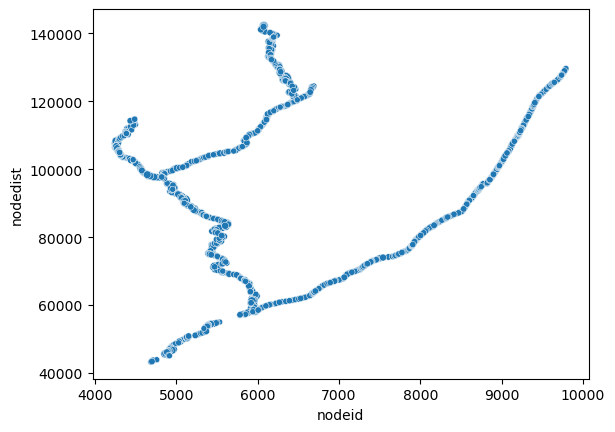

In [91]:
sns.scatterplot(mito_2130887, x='nodeid', y='nodedist', size='count', hue='compartment', legend=False)

In [64]:
mito1 = 2130887
mito2 = 1534008

In [65]:
mito_query = node_metrics_merge[(node_metrics_merge.mitoid == mito1) | (node_metrics_merge.mitoid == mito2)]
mito_query

,cellid,mitoid,count,diams,nodedist,nodeid,cellid_str,mitoid_str,surface_area,complexityindex,compartment
1589641,648518346349539768,1534008,23,0.366390,106025.442389,430,648518346349539768,1534008,23.127471,102.435936,Basal
1589642,648518346349539768,1534008,21,0.401322,106154.267447,425,648518346349539768,1534008,23.127471,102.435936,Basal
1589643,648518346349539768,1534008,22,0.503683,104060.828238,495,648518346349539768,1534008,23.127471,102.435936,Basal
1589644,648518346349539768,1534008,22,0.562762,102301.194227,545,648518346349539768,1534008,23.127471,102.435936,Basal
1589645,648518346349539768,1534008,28,0.574428,102410.563223,543,648518346349539768,1534008,23.127471,102.435936,Basal
...,...,...,...,...,...,...,...,...,...,...,...
1660605,648518346349537741,2130887,23,0.559141,127854.411791,9741,648518346349537741,2130887,172.350161,524.219832,Unknown
1660606,648518346349537741,2130887,15,0.746267,125589.038126,9647,648518346349537741,2130887,172.350161,524.219832,Unknown
1660607,648518346349537741,2130887,19,0.335826,127200.014742,9721,648518346349537741,2130887,172.350161,524.219832,Unknown
1660608,648518346349537741,2130887,18,0.752429,127570.359468,9732,648518346349537741,2130887,172.350161,524.219832,Unknown


In [74]:
fig = px.scatter_3d(mito_query, 
                    x='nodeid', 
                    y='count', 
                    z='nodedist', 
                    size='diams', 
                    color='compartment',
                   hover_data=['cellid_str','count', 'mitoid_str', 'compartment'])
fig.update_traces(marker=dict(
    line=dict(width=0)
))
                  
fig.show()

In [75]:
# pull all mitos from cellid 648518346349537741

cellid = 648518346349537741
cellquery = node_metrics_merge[node_metrics_merge['cellid'] == cellid]
len(cellquery.mitoid.unique())

437

In [76]:
fig = px.scatter(cellquery, 
                    x='nodeid', 
                    y='nodedist', 
                    size='count', 
                    color='mitoid_str',
                    hover_data=['cellid_str','count', 'mitoid_str', 'diams'])
fig.update_traces(marker=dict(
    line=dict(width=0)
))
    
fig.show()

In [78]:
fig = px.scatter_3d(cellquery, 
                    x='nodeid', 
                    y='diams', 
                    z='nodedist', 
                    size='count', 
                    color='mitoid_str', # 'compartment' or 'mitoid_str'
                    hover_data=['cellid_str','count', 'mitoid_str'])
fig.update_traces(marker=dict(
    line=dict(width=0)
))

fig.show()

In [79]:
# mito 2239350 has a relatively large diams but looks unremarkable in Neuroglancer

mito_2239350 = node_metrics_merge[node_metrics_merge.mitoid == 2239350]
mito_2239350

,cellid,mitoid,count,diams,nodedist,nodeid,cellid_str,mitoid_str,surface_area,complexityindex,compartment
1659038,648518346349537741,2239350,323,6.974129,138002.202478,5789,648518346349537741,2239350,1.312214,6.143192,Unknown


In [56]:
# pull all mitos from cellid 648518346349538440

cellid = 648518346349538440
cellquery = node_metrics_merge[node_metrics_merge['cellid'] == cellid]
len(cellquery.mitoid.unique())

969

In [57]:
fig = px.scatter(cellquery, 
                    x='nodeid', 
                    y='nodedist', 
                    size='count', 
                    color='compartment',
                    hover_data=['cellid_str','mitoid_str','count','surface_area','complexityindex'])
fig.update_traces(marker=dict(
    line=dict(width=0)
))
    
fig.show()

In [62]:
fig = px.scatter_3d(cellquery, 
                    x='nodeid', 
                    y='count', 
                    z='nodedist', 
                    size='diams', 
                    color='compartment',
                    hover_data=['cellid_str','count', 'mitoid_str', 'compartment'])
fig.update_traces(marker=dict(
    line=dict(width=0)
))

fig.show()

# Neuroglancer views of 648518346349538440

- [Neuroglancer](https://neuromancer-seung-import.appspot.com/#!%7B%22layers%22:%5B%7B%22source%22:%22precomputed://gs://microns_public_datasets/pinky100_v0/son_of_alignment_v15_rechunked%22%2C%22type%22:%22image%22%2C%22blend%22:%22default%22%2C%22shaderControls%22:%7B%7D%2C%22name%22:%22EM%22%7D%2C%7B%22source%22:%22precomputed://gs://microns_public_datasets/pinky100_v185/seg%22%2C%22type%22:%22segmentation%22%2C%22selectedAlpha%22:0.51%2C%22objectAlpha%22:0.15%2C%22colorSeed%22:3550118538%2C%22segments%22:%5B%22648518346349538440%22%5D%2C%22skeletonRendering%22:%7B%22mode2d%22:%22lines_and_points%22%2C%22mode3d%22:%22lines%22%7D%2C%22name%22:%22cell_segmentation_v185%22%7D%2C%7B%22source%22:%22precomputed://matrix://sseung-archive/pinky100-clefts/mip1_d2_1175k%22%2C%22type%22:%22segmentation%22%2C%22colorSeed%22:2238886267%2C%22skeletonRendering%22:%7B%22mode2d%22:%22lines_and_points%22%2C%22mode3d%22:%22lines%22%7D%2C%22name%22:%22synapses%22%7D%2C%7B%22source%22:%22precomputed://matrix://sseung-archive/pinky100-mito/seg_191220%22%2C%22type%22:%22segmentation%22%2C%22colorSeed%22:3954962296%2C%22segments%22:%5B%221007877%22%2C%221008644%22%2C%221009531%22%2C%221010113%22%2C%221011071%22%2C%221011201%22%2C%221011294%22%2C%221013533%22%2C%221016310%22%2C%221026057%22%2C%221035809%22%2C%221077528%22%2C%221079282%22%2C%221117847%22%2C%221118897%22%2C%221122154%22%2C%221123443%22%2C%221123595%22%2C%221123966%22%2C%221124927%22%2C%221131120%22%2C%221138160%22%2C%221138588%22%2C%221228653%22%2C%221229951%22%2C%221231342%22%2C%221235269%22%2C%221245539%22%2C%221245921%22%2C%221263167%22%2C%221263207%22%2C%221349546%22%2C%221349932%22%2C%221351626%22%2C%221351980%22%2C%221352751%22%2C%221353015%22%2C%221371635%22%2C%221376271%22%2C%221412548%22%2C%221437108%22%2C%221441918%22%2C%221459529%22%2C%221482084%22%2C%221569770%22%2C%221570448%22%2C%221570624%22%2C%221573918%22%2C%221574159%22%2C%221574236%22%2C%221574984%22%2C%221574993%22%2C%221578532%22%2C%221578570%22%2C%221580488%22%2C%221584330%22%2C%221585327%22%2C%221585362%22%2C%221593598%22%2C%221643115%22%2C%221647370%22%2C%221673170%22%2C%221678995%22%2C%221683128%22%2C%221683257%22%2C%221683586%22%2C%221683648%22%2C%221683774%22%2C%221683831%22%2C%221683869%22%2C%221684028%22%2C%221688178%22%2C%221688507%22%2C%221690055%22%2C%221694347%22%2C%221694837%22%2C%221700293%22%2C%221700439%22%2C%221722511%22%2C%221722953%22%2C%221729010%22%2C%221765648%22%2C%221769618%22%2C%221771630%22%2C%221798812%22%2C%221802642%22%2C%221802734%22%2C%221804036%22%2C%221809668%22%2C%221810367%22%2C%221811085%22%2C%221813502%22%2C%221813775%22%2C%221814291%22%2C%221815300%22%2C%221815474%22%2C%221818934%22%2C%221820102%22%2C%221820193%22%2C%221825345%22%2C%221828432%22%2C%221833337%22%2C%221838546%22%2C%221847136%22%2C%221848403%22%2C%221853478%22%2C%221891845%22%2C%221920100%22%2C%221920355%22%2C%221921004%22%2C%221921167%22%2C%221921580%22%2C%221923375%22%2C%221925896%22%2C%221926635%22%2C%221927175%22%2C%221927241%22%2C%221927541%22%2C%221927682%22%2C%221928367%22%2C%221931628%22%2C%221931632%22%2C%221931894%22%2C%221945223%22%2C%221945303%22%2C%221950024%22%2C%221955635%22%2C%221955685%22%2C%221955844%22%2C%221961527%22%2C%221966239%22%2C%221967548%22%2C%221972429%22%2C%222005643%22%2C%222010995%22%2C%222015237%22%2C%222033722%22%2C%222037410%22%2C%222037436%22%2C%222038659%22%2C%222038916%22%2C%222038953%22%2C%222039059%22%2C%222039153%22%2C%222039314%22%2C%222039408%22%2C%222039464%22%2C%222040190%22%2C%222040202%22%2C%222041084%22%2C%222042533%22%2C%222043040%22%2C%222043233%22%2C%222044831%22%2C%222047173%22%2C%222047341%22%2C%222052239%22%2C%222058768%22%2C%222060001%22%2C%222122915%22%2C%222123149%22%2C%222123157%22%2C%222124446%22%2C%222126995%22%2C%222127217%22%2C%222127360%22%2C%222127818%22%2C%222127947%22%2C%222129164%22%2C%222130823%22%2C%222131000%22%2C%222144715%22%2C%222148940%22%2C%222149145%22%2C%222149190%22%2C%222149214%22%2C%222149229%22%2C%222149277%22%2C%222149285%22%2C%222149338%22%2C%222149384%22%2C%222149388%22%2C%222149390%22%2C%222149397%22%2C%222149416%22%2C%222149440%22%2C%222149476%22%2C%222150513%22%2C%222150601%22%2C%222150633%22%2C%222150917%22%2C%222151067%22%2C%222151099%22%2C%222151278%22%2C%222151308%22%2C%222151370%22%2C%222151379%22%2C%222151784%22%2C%222151813%22%2C%222151981%22%2C%222152123%22%2C%222152131%22%2C%222152170%22%2C%222152954%22%2C%222152981%22%2C%222153023%22%2C%222153054%22%2C%222153058%22%2C%222153065%22%2C%222153080%22%2C%222153083%22%2C%222153093%22%2C%222153108%22%2C%222153138%22%2C%222153150%22%2C%222153156%22%2C%222153166%22%2C%222153167%22%2C%222153202%22%2C%222153206%22%2C%222153210%22%2C%222153211%22%2C%222153223%22%2C%222153224%22%2C%222153226%22%2C%222153228%22%2C%222153231%22%2C%222153235%22%2C%222153239%22%2C%222153244%22%2C%222153258%22%2C%222153264%22%2C%222153274%22%2C%222153289%22%2C%222153296%22%2C%222153302%22%2C%222153313%22%2C%222153340%22%2C%222153342%22%2C%222153351%22%2C%222153352%22%2C%222153358%22%2C%222153366%22%2C%222153368%22%2C%222153372%22%2C%222153373%22%2C%222153376%22%2C%222153377%22%2C%222153379%22%2C%222153392%22%2C%222153393%22%2C%222153395%22%2C%222153397%22%2C%222153398%22%2C%222153399%22%2C%222153400%22%2C%222153420%22%2C%222153450%22%2C%222153454%22%2C%222153470%22%2C%222153499%22%2C%222153507%22%2C%222153519%22%2C%222153522%22%2C%222153526%22%2C%222153533%22%2C%222153554%22%2C%222153560%22%2C%222153581%22%2C%222153582%22%2C%222153594%22%2C%222153598%22%2C%222153632%22%2C%222153641%22%2C%222153652%22%2C%222153680%22%2C%222153684%22%2C%222153692%22%2C%222153701%22%2C%222153729%22%2C%222153734%22%2C%222153758%22%2C%222153772%22%2C%222153796%22%2C%222153819%22%2C%222153864%22%2C%222153884%22%2C%222153892%22%2C%222153951%22%2C%222153997%22%2C%222154080%22%2C%222154087%22%2C%222154091%22%2C%222154138%22%2C%222154144%22%2C%222154147%22%2C%222154151%22%2C%222154166%22%2C%222154181%22%2C%222154206%22%2C%222154222%22%2C%222154230%22%2C%222154240%22%2C%222154251%22%2C%222154274%22%2C%222154278%22%2C%222154282%22%2C%222154286%22%2C%222154318%22%2C%222154323%22%2C%222154343%22%2C%222154689%22%2C%222154699%22%2C%222154866%22%2C%222155109%22%2C%222155189%22%2C%222155500%22%2C%222155560%22%2C%222155781%22%2C%222155982%22%2C%222156071%22%2C%222156147%22%2C%222157648%22%2C%222157850%22%2C%222157869%22%2C%222158070%22%2C%222158071%22%2C%222158119%22%2C%222158124%22%2C%222158132%22%2C%222158148%22%2C%222158150%22%2C%222158191%22%2C%222158227%22%2C%222158231%22%2C%222158290%22%2C%222158294%22%2C%222158304%22%2C%222158324%22%2C%222158379%22%2C%222158401%22%2C%222158418%22%2C%222158423%22%2C%222158470%22%2C%222158471%22%2C%222158483%22%2C%222158485%22%2C%222158495%22%2C%222158507%22%2C%222158549%22%2C%222158558%22%2C%222158561%22%2C%222158564%22%2C%222158567%22%2C%222158652%22%2C%222158680%22%2C%222158687%22%2C%222158705%22%2C%222158712%22%2C%222158718%22%2C%222158735%22%2C%222158747%22%2C%222158753%22%2C%222158762%22%2C%222158798%22%2C%222158802%22%2C%222158864%22%2C%222158883%22%2C%222158892%22%2C%222158899%22%2C%222158906%22%2C%222158927%22%2C%222158950%22%2C%222158958%22%2C%222158962%22%2C%222158981%22%2C%222161739%22%2C%222168932%22%2C%222174929%22%2C%222175108%22%2C%222175196%22%2C%222178055%22%2C%222178712%22%2C%222179015%22%2C%222179757%22%2C%222202967%22%2C%222203220%22%2C%222203515%22%2C%222231378%22%2C%222237639%22%2C%222242917%22%2C%222245572%22%2C%222245838%22%2C%222246682%22%2C%222247182%22%2C%222250180%22%2C%222251900%22%2C%222251957%22%2C%222251970%22%2C%222252040%22%2C%222252127%22%2C%222252164%22%2C%222252202%22%2C%222253406%22%2C%222253542%22%2C%222256248%22%2C%222256325%22%2C%222256411%22%2C%222256542%22%2C%222256545%22%2C%222256565%22%2C%222256632%22%2C%222260692%22%2C%222260728%22%2C%222260747%22%2C%222260768%22%2C%222260789%22%2C%222260882%22%2C%222260944%22%2C%222260951%22%2C%222260984%22%2C%222261015%22%2C%222261025%22%2C%222261038%22%2C%222261043%22%2C%222261076%22%2C%222261122%22%2C%222261123%22%2C%222261234%22%2C%222261303%22%2C%222261585%22%2C%222264207%22%2C%222264248%22%2C%222264287%22%2C%222264454%22%2C%222265495%22%2C%222265642%22%2C%222265670%22%2C%222265686%22%2C%222265696%22%2C%222265716%22%2C%222265723%22%2C%222265735%22%2C%222265779%22%2C%222265810%22%2C%222265812%22%2C%222265922%22%2C%222265926%22%2C%222265937%22%2C%222266009%22%2C%222266035%22%2C%222266078%22%2C%222266085%22%2C%222266108%22%2C%222266115%22%2C%222266251%22%2C%222266292%22%2C%222266294%22%2C%222266339%22%2C%222266465%22%2C%222266566%22%2C%222266775%22%2C%222267755%22%2C%222267874%22%2C%222267895%22%2C%222267960%22%2C%222268294%22%2C%222268434%22%2C%222268494%22%2C%222268672%22%2C%222268858%22%2C%222268923%22%2C%222268970%22%2C%222269293%22%2C%222269380%22%2C%222270417%22%2C%222270437%22%2C%222270517%22%2C%222270557%22%2C%222270625%22%2C%222270635%22%2C%222270674%22%2C%222270730%22%2C%222270759%22%2C%222270812%22%2C%222270821%22%2C%222270864%22%2C%222270865%22%2C%222270870%22%2C%222270894%22%2C%222270928%22%2C%222270946%22%2C%222270959%22%2C%222271004%22%2C%222271015%22%2C%222271019%22%2C%222271022%22%2C%222271029%22%2C%222271035%22%2C%222271116%22%2C%222271165%22%2C%222271204%22%2C%222271266%22%2C%222271276%22%2C%222271294%22%2C%222271300%22%2C%222271306%22%2C%222271310%22%2C%222271313%22%2C%222271330%22%2C%222271332%22%2C%222271347%22%2C%222271359%22%2C%222271371%22%2C%222271374%22%2C%222271376%22%2C%222271381%22%2C%222271382%22%2C%222271385%22%2C%222271403%22%2C%222271425%22%2C%222271441%22%2C%222271453%22%2C%222271459%22%2C%222271461%22%2C%222271464%22%2C%222271502%22%2C%222271556%22%2C%222271569%22%2C%222271628%22%2C%222271663%22%2C%222271679%22%2C%222271716%22%2C%222271731%22%2C%222271748%22%2C%222271770%22%2C%222271794%22%2C%222271806%22%2C%222271814%22%2C%222271815%22%2C%222271847%22%2C%222271887%22%2C%222271914%22%2C%222271919%22%2C%222271933%22%2C%222272014%22%2C%222272839%22%2C%222274883%22%2C%222274939%22%2C%222274940%22%2C%222274947%22%2C%222274953%22%2C%222274976%22%2C%222274987%22%2C%222274990%22%2C%222274992%22%2C%222275010%22%2C%222275011%22%2C%222275016%22%2C%222275017%22%2C%222275022%22%2C%222275023%22%2C%222275025%22%2C%222275032%22%2C%222275034%22%2C%222275039%22%2C%222275073%22%2C%222275105%22%2C%222275136%22%2C%222275189%22%2C%222275196%22%2C%222275215%22%2C%222275265%22%2C%222275296%22%2C%222275309%22%2C%222275336%22%2C%222275348%22%2C%222275349%22%2C%222275369%22%2C%222275380%22%2C%222275396%22%2C%222275517%22%2C%222275527%22%2C%222275531%22%2C%222275552%22%2C%222275579%22%2C%222275624%22%2C%222275634%22%2C%222275702%22%2C%222275729%22%2C%222275772%22%2C%222275789%22%2C%222275833%22%2C%222275851%22%2C%222275869%22%2C%222275907%22%2C%222275936%22%2C%222275951%22%2C%222275956%22%2C%222275962%22%2C%222276012%22%2C%222276018%22%2C%222276029%22%2C%222276095%22%2C%222276177%22%2C%222276232%22%2C%222276266%22%2C%222276274%22%2C%222276339%22%2C%222276355%22%2C%222276469%22%2C%222278849%22%2C%222278908%22%2C%222278933%22%2C%222284475%22%2C%222284490%22%2C%222284507%22%2C%222284515%22%2C%222284521%22%2C%222284546%22%2C%222284696%22%2C%222285261%22%2C%222289403%22%2C%222289797%22%2C%222290950%22%2C%222292719%22%2C%222300260%22%2C%222300355%22%2C%222300370%22%2C%222300391%22%2C%222300797%22%2C%222301112%22%2C%222307242%22%2C%222322785%22%2C%222355557%22%2C%222356769%22%2C%222359853%22%2C%222360057%22%2C%222361590%22%2C%222363125%22%2C%222370474%22%2C%222375850%22%2C%222382241%22%2C%222382431%22%2C%222385352%22%2C%222386189%22%2C%222389771%22%2C%222389912%22%2C%222389990%22%2C%222390007%22%2C%222392216%22%2C%222393223%22%2C%222393911%22%2C%222394285%22%2C%222395782%22%2C%222396089%22%2C%222396279%22%2C%222397849%22%2C%222398102%22%2C%222398399%22%2C%222398740%22%2C%222398885%22%2C%222398977%22%2C%222399004%22%2C%222401362%22%2C%222402793%22%2C%222402848%22%2C%222416204%22%2C%222419754%22%2C%222421268%22%2C%222421477%22%2C%222421478%22%2C%222426169%22%2C%222426254%22%2C%222426306%22%2C%222426326%22%2C%222426462%22%2C%222426489%22%2C%222429032%22%2C%222429623%22%2C%222430451%22%2C%222431479%22%2C%222431730%22%2C%222435179%22%2C%222436655%22%2C%222436726%22%2C%222442710%22%2C%222476746%22%2C%222476818%22%2C%222476881%22%2C%222482598%22%2C%222486999%22%2C%222487687%22%2C%222487818%22%2C%222488942%22%2C%222491878%22%2C%222492001%22%2C%222496326%22%2C%222496958%22%2C%222496975%22%2C%222497578%22%2C%222499602%22%2C%222500616%22%2C%222501256%22%2C%222511572%22%2C%222512334%22%2C%222512644%22%2C%222512704%22%2C%222512960%22%2C%222513064%22%2C%222513521%22%2C%222513690%22%2C%222514139%22%2C%222515862%22%2C%222531419%22%2C%222531431%22%2C%222531510%22%2C%222543858%22%2C%222543913%22%2C%222545443%22%2C%222546345%22%2C%222547667%22%2C%222548189%22%2C%222549175%22%2C%222563498%22%2C%222563545%22%2C%222563682%22%2C%222563752%22%2C%222608930%22%2C%222609455%22%2C%222609925%22%2C%222617793%22%2C%222622375%22%2C%222626372%22%2C%222626418%22%2C%222628635%22%2C%222629337%22%2C%222630193%22%2C%222630285%22%2C%222630392%22%2C%222630540%22%2C%222632161%22%2C%222632838%22%2C%222633675%22%2C%222635064%22%2C%222640122%22%2C%222640421%22%2C%222643440%22%2C%222643950%22%2C%222644106%22%2C%222648584%22%2C%222648585%22%2C%222654937%22%2C%222655520%22%2C%222663930%22%2C%222668608%22%2C%222668895%22%2C%222670254%22%2C%222717679%22%2C%222723735%22%2C%222726449%22%2C%222752409%22%2C%222758567%22%2C%222758578%22%2C%222759756%22%2C%222764367%22%2C%222767801%22%2C%222768047%22%2C%222768603%22%2C%222769349%22%2C%222772332%22%2C%222772735%22%2C%222773496%22%2C%222779080%22%2C%222782504%22%2C%222839444%22%2C%222840621%22%2C%222842173%22%2C%222857998%22%2C%222863009%22%2C%222866225%22%2C%222866366%22%2C%222867653%22%2C%222869374%22%2C%222869525%22%2C%222871264%22%2C%222871771%22%2C%222879383%22%2C%222879462%22%2C%222880070%22%2C%222947080%22%2C%222951694%22%2C%222953209%22%2C%222970090%22%2C%222970388%22%2C%222970536%22%2C%222972820%22%2C%222972971%22%2C%222973088%22%2C%222983940%22%2C%222984352%22%2C%222987107%22%2C%223000881%22%2C%223057674%22%2C%223063363%22%2C%223064143%22%2C%223075716%22%2C%223083831%22%2C%223087357%22%2C%223087424%22%2C%223088487%22%2C%223088651%22%2C%223092101%22%2C%223097334%22%2C%223097909%22%2C%223098405%22%2C%223098428%22%2C%223116234%22%2C%223171402%22%2C%223171641%22%2C%223172488%22%2C%223183494%22%2C%223196507%22%2C%223197078%22%2C%223197599%22%2C%223199923%22%2C%223200119%22%2C%223200850%22%2C%223200935%22%2C%223211390%22%2C%223270301%22%2C%223279134%22%2C%223279286%22%2C%223281747%22%2C%223285528%22%2C%223303937%22%2C%223304005%22%2C%223304735%22%2C%223311494%22%2C%223312959%22%2C%223319213%22%2C%223380725%22%2C%223387989%22%2C%223388115%22%2C%223393560%22%2C%223393951%22%2C%223393958%22%2C%223398291%22%2C%223398350%22%2C%223402891%22%2C%223403251%22%2C%223406542%22%2C%223407230%22%2C%223415773%22%2C%223416516%22%2C%223416855%22%2C%223417090%22%2C%223417250%22%2C%223420222%22%2C%223420345%22%2C%223421040%22%2C%223421529%22%2C%223492033%22%2C%223503361%22%2C%223504212%22%2C%223511726%22%2C%223512177%22%2C%223513082%22%2C%223514142%22%2C%223521523%22%2C%223526624%22%2C%223527346%22%2C%223527464%22%2C%223535250%22%2C%223535921%22%2C%223539910%22%2C%223541585%22%2C%223603166%22%2C%223611098%22%2C%223621155%22%2C%223621364%22%2C%223621734%22%2C%223622507%22%2C%223625980%22%2C%223626074%22%2C%223626381%22%2C%223631757%22%2C%223648089%22%2C%223723551%22%2C%223724145%22%2C%223724686%22%2C%223725842%22%2C%223726135%22%2C%223726211%22%2C%223728606%22%2C%223730061%22%2C%223730148%22%2C%223738931%22%2C%223739373%22%2C%223742735%22%2C%223742900%22%2C%223742936%22%2C%223777222%22%2C%223834634%22%2C%223834657%22%2C%223837296%22%2C%223837773%22%2C%223837922%22%2C%223849293%22%2C%223850274%22%2C%223850644%22%2C%223850829%22%2C%223855446%22%2C%223856080%22%2C%223892585%22%2C%223942706%22%2C%223942859%22%2C%223950620%22%2C%223953204%22%2C%223965251%22%2C%223966574%22%2C%223966674%22%2C%223968630%22%2C%223971092%22%2C%223971175%22%2C%223971614%22%2C%224057953%22%2C%224067158%22%2C%224076714%22%2C%224076971%22%2C%224085162%22%2C%224085785%22%2C%224086478%22%2C%224167059%22%2C%224187029%22%2C%224199727%22%2C%22470360%22%2C%22470393%22%2C%22476358%22%2C%22476437%22%2C%22481049%22%2C%22559406%22%2C%22566342%22%2C%22589472%22%2C%22590010%22%2C%22590361%22%2C%22591368%22%2C%22673081%22%2C%22674759%22%2C%22691357%22%2C%22738778%22%2C%22781306%22%2C%22782210%22%2C%22784493%22%2C%22794106%22%2C%22794955%22%2C%22812235%22%2C%22890936%22%2C%22894871%22%2C%22895357%22%2C%22897722%22%2C%22904205%22%2C%22915159%22%2C%22918834%22%2C%22918930%22%2C%22924364%22%2C%22925368%22%2C%22930760%22%2C%22966813%22%5D%2C%22skeletonRendering%22:%7B%22mode2d%22:%22lines_and_points%22%2C%22mode3d%22:%22lines%22%7D%2C%22name%22:%22mitochondria%22%7D%2C%7B%22source%22:%22precomputed://matrix://sseung-archive/pinky100-nuclei/seg%22%2C%22type%22:%22segmentation%22%2C%22colorSeed%22:1265044942%2C%22skeletonRendering%22:%7B%22mode2d%22:%22lines_and_points%22%2C%22mode3d%22:%22lines%22%7D%2C%22name%22:%22nuclei%22%7D%5D%2C%22navigation%22:%7B%22pose%22:%7B%22position%22:%7B%22voxelSize%22:%5B4%2C4%2C40%5D%2C%22voxelCoordinates%22:%5B84667.75%2C56567.23828125%2C1657.0611572265625%5D%7D%7D%2C%22zoomFactor%22:383.0066650796121%7D%2C%22perspectiveOrientation%22:%5B0.04576745256781578%2C0.24890455603599548%2C-0.013399044051766396%2C0.9673532843589783%5D%2C%22perspectiveZoom%22:2213.8789840670624%2C%22showSlices%22:false%2C%22selectedLayer%22:%7B%22layer%22:%22cell_segmentation_v185%22%2C%22visible%22:true%7D%2C%22layout%22:%7B%22type%22:%223d%22%2C%22orthographicProjection%22:true%7D%7D) view of all mitos
- [Neuroglancer](https://neuromancer-seung-import.appspot.com/#!%7B%22layers%22:%5B%7B%22source%22:%22precomputed://gs://microns_public_datasets/pinky100_v0/son_of_alignment_v15_rechunked%22%2C%22type%22:%22image%22%2C%22blend%22:%22default%22%2C%22shaderControls%22:%7B%7D%2C%22name%22:%22EM%22%7D%2C%7B%22source%22:%22precomputed://gs://microns_public_datasets/pinky100_v185/seg%22%2C%22type%22:%22segmentation%22%2C%22selectedAlpha%22:0.51%2C%22objectAlpha%22:0.15%2C%22segments%22:%5B%22648518346349538440%22%5D%2C%22skeletonRendering%22:%7B%22mode2d%22:%22lines_and_points%22%2C%22mode3d%22:%22lines%22%7D%2C%22name%22:%22cell_segmentation_v185%22%7D%2C%7B%22source%22:%22precomputed://matrix://sseung-archive/pinky100-clefts/mip1_d2_1175k%22%2C%22type%22:%22segmentation%22%2C%22skeletonRendering%22:%7B%22mode2d%22:%22lines_and_points%22%2C%22mode3d%22:%22lines%22%7D%2C%22name%22:%22synapses%22%7D%2C%7B%22source%22:%22precomputed://matrix://sseung-archive/pinky100-mito/seg_191220%22%2C%22type%22:%22segmentation%22%2C%22segments%22:%5B%221077528%22%2C%221079282%22%2C%221412548%22%2C%221643115%22%2C%221647370%22%2C%221765648%22%2C%221769618%22%2C%221771630%22%2C%221891845%22%2C%222005643%22%2C%222010995%22%2C%222015237%22%2C%222122915%22%2C%222123149%22%2C%222123157%22%2C%222124446%22%2C%222126995%22%2C%222127217%22%2C%222127360%22%2C%222127818%22%2C%222127947%22%2C%222129164%22%2C%222130823%22%2C%222131000%22%2C%222231378%22%2C%222237639%22%2C%222242917%22%2C%222245572%22%2C%222245838%22%2C%222246682%22%2C%222247182%22%2C%222250180%22%2C%222251900%22%2C%222251957%22%2C%222251970%22%2C%222252040%22%2C%222252127%22%2C%222252164%22%2C%222252202%22%2C%222253406%22%2C%222253542%22%2C%222256248%22%2C%222256325%22%2C%222256411%22%2C%222256542%22%2C%222256545%22%2C%222256565%22%2C%222256632%22%2C%222260747%22%2C%222260768%22%2C%222260882%22%2C%222261025%22%2C%222261038%22%2C%222261076%22%2C%222261122%22%2C%222261123%22%2C%222261234%22%2C%222261303%22%2C%222261585%22%2C%222355557%22%2C%222359853%22%2C%222360057%22%2C%222363125%22%2C%222370474%22%2C%222375850%22%2C%222382241%22%2C%222382431%22%2C%222385352%22%2C%222386189%22%2C%222389771%22%2C%222389990%22%2C%222476746%22%2C%222476818%22%2C%222476881%22%2C%222486999%22%2C%222488942%22%2C%222496958%22%2C%222496975%22%2C%222497578%22%2C%222499602%22%2C%222608930%22%2C%222609455%22%2C%222609925%22%2C%222717679%22%2C%222723735%22%2C%222726449%22%2C%222839444%22%2C%222840621%22%2C%222947080%22%2C%222951694%22%2C%222953209%22%2C%223057674%22%2C%223063363%22%2C%223064143%22%2C%223171402%22%2C%223171641%22%2C%223172488%22%2C%223270301%22%2C%223279134%22%2C%223279286%22%2C%223281747%22%2C%223380725%22%2C%223387989%22%2C%223388115%22%2C%223492033%22%2C%223603166%22%2C%223611098%22%2C%223724145%22%2C%223724686%22%2C%223953204%22%2C%22738778%22%2C%22966813%22%5D%2C%22skeletonRendering%22:%7B%22mode2d%22:%22lines_and_points%22%2C%22mode3d%22:%22lines%22%7D%2C%22name%22:%22mitochondria%22%7D%2C%7B%22source%22:%22precomputed://matrix://sseung-archive/pinky100-nuclei/seg%22%2C%22type%22:%22segmentation%22%2C%22skeletonRendering%22:%7B%22mode2d%22:%22lines_and_points%22%2C%22mode3d%22:%22lines%22%7D%2C%22name%22:%22nuclei%22%7D%5D%2C%22navigation%22:%7B%22pose%22:%7B%22position%22:%7B%22voxelSize%22:%5B4%2C4%2C40%5D%2C%22voxelCoordinates%22:%5B82709.5078125%2C51427.046875%2C1141.10400390625%5D%7D%7D%2C%22zoomFactor%22:383.0066650796121%7D%2C%22perspectiveOrientation%22:%5B-0.09036783128976822%2C-0.04220915213227272%2C-0.00819767639040947%2C0.9949797987937927%5D%2C%22perspectiveZoom%22:1652.1475196643182%2C%22showSlices%22:false%2C%22selectedLayer%22:%7B%22layer%22:%22mitochondria%22%2C%22visible%22:true%7D%2C%22layout%22:%7B%22type%22:%223d%22%2C%22orthographicProjection%22:true%7D%7D) view of mitos labeled apical by Turner algorithm (one basal dendrite is misclassified as apical)
- [Neuroglancer](https://neuromancer-seung-import.appspot.com/#!%7B%22layers%22:%5B%7B%22source%22:%22precomputed://gs://microns_public_datasets/pinky100_v0/son_of_alignment_v15_rechunked%22%2C%22type%22:%22image%22%2C%22blend%22:%22default%22%2C%22shaderControls%22:%7B%7D%2C%22name%22:%22EM%22%7D%2C%7B%22source%22:%22precomputed://gs://microns_public_datasets/pinky100_v185/seg%22%2C%22type%22:%22segmentation%22%2C%22selectedAlpha%22:0.51%2C%22objectAlpha%22:0.15%2C%22segments%22:%5B%22648518346349538440%22%5D%2C%22skeletonRendering%22:%7B%22mode2d%22:%22lines_and_points%22%2C%22mode3d%22:%22lines%22%7D%2C%22name%22:%22cell_segmentation_v185%22%7D%2C%7B%22source%22:%22precomputed://matrix://sseung-archive/pinky100-clefts/mip1_d2_1175k%22%2C%22type%22:%22segmentation%22%2C%22skeletonRendering%22:%7B%22mode2d%22:%22lines_and_points%22%2C%22mode3d%22:%22lines%22%7D%2C%22name%22:%22synapses%22%7D%2C%7B%22source%22:%22precomputed://matrix://sseung-archive/pinky100-mito/seg_191220%22%2C%22type%22:%22segmentation%22%2C%22segments%22:%5B%221007877%22%2C%221008644%22%2C%221009531%22%2C%221010113%22%2C%221011071%22%2C%221011201%22%2C%221011294%22%2C%221013533%22%2C%221016310%22%2C%221026057%22%2C%221117847%22%2C%221118897%22%2C%221122154%22%2C%221123443%22%2C%221123595%22%2C%221123966%22%2C%221124927%22%2C%221131120%22%2C%221138160%22%2C%221138588%22%2C%221228653%22%2C%221229951%22%2C%221231342%22%2C%221235269%22%2C%221245539%22%2C%221245921%22%2C%221263167%22%2C%221349546%22%2C%221349932%22%2C%221351626%22%2C%221351980%22%2C%221352751%22%2C%221353015%22%2C%221371635%22%2C%221437108%22%2C%221441918%22%2C%221459529%22%2C%221482084%22%2C%221569770%22%2C%221570448%22%2C%221570624%22%2C%221573918%22%2C%221574159%22%2C%221574236%22%2C%221574984%22%2C%221574993%22%2C%221578532%22%2C%221578570%22%2C%221580488%22%2C%221584330%22%2C%221585327%22%2C%221585362%22%2C%221593598%22%2C%221673170%22%2C%221678995%22%2C%221683128%22%2C%221683257%22%2C%221683586%22%2C%221683648%22%2C%221683774%22%2C%221683831%22%2C%221683869%22%2C%221684028%22%2C%221688178%22%2C%221688507%22%2C%221690055%22%2C%221694347%22%2C%221694837%22%2C%221700293%22%2C%221700439%22%2C%221722511%22%2C%221722953%22%2C%221798812%22%2C%221802642%22%2C%221802734%22%2C%221804036%22%2C%221809668%22%2C%221810367%22%2C%221811085%22%2C%221813502%22%2C%221813775%22%2C%221814291%22%2C%221815300%22%2C%221815474%22%2C%221818934%22%2C%221820102%22%2C%221820193%22%2C%221825345%22%2C%221828432%22%2C%221833337%22%2C%221838546%22%2C%221853478%22%2C%221920100%22%2C%221920355%22%2C%221921004%22%2C%221921167%22%2C%221921580%22%2C%221923375%22%2C%221925896%22%2C%221926635%22%2C%221927175%22%2C%221927241%22%2C%221927541%22%2C%221927682%22%2C%221928367%22%2C%221931628%22%2C%221931632%22%2C%221931894%22%2C%221945223%22%2C%221945303%22%2C%221950024%22%2C%221955635%22%2C%221955685%22%2C%221955844%22%2C%221961527%22%2C%222033722%22%2C%222037410%22%2C%222038659%22%2C%222038916%22%2C%222038953%22%2C%222039153%22%2C%222039314%22%2C%222040190%22%2C%222040202%22%2C%222041084%22%2C%222042533%22%2C%222043040%22%2C%222043233%22%2C%222044831%22%2C%222047173%22%2C%222047341%22%2C%222052239%22%2C%222058768%22%2C%222060001%22%2C%222161739%22%2C%222168932%22%2C%222174929%22%2C%222175108%22%2C%222175196%22%2C%222178055%22%2C%222178712%22%2C%222179015%22%2C%222179757%22%2C%222285261%22%2C%222290950%22%2C%222292719%22%2C%222300797%22%2C%222301112%22%2C%222307242%22%2C%222393223%22%2C%222393911%22%2C%222394285%22%2C%222395782%22%2C%222396089%22%2C%222396279%22%2C%222397849%22%2C%222398102%22%2C%222398399%22%2C%222398740%22%2C%222398885%22%2C%222398977%22%2C%222399004%22%2C%222401362%22%2C%222402793%22%2C%222402848%22%2C%222419754%22%2C%222429032%22%2C%222429623%22%2C%222430451%22%2C%222435179%22%2C%222512334%22%2C%222512644%22%2C%222512704%22%2C%222512960%22%2C%222513064%22%2C%222513521%22%2C%222513690%22%2C%222514139%22%2C%222515862%22%2C%222531419%22%2C%222531431%22%2C%222531510%22%2C%222545443%22%2C%222546345%22%2C%222617793%22%2C%222622375%22%2C%222626372%22%2C%222626418%22%2C%222629337%22%2C%222630193%22%2C%222630285%22%2C%222630392%22%2C%222630540%22%2C%222632161%22%2C%222632838%22%2C%222633675%22%2C%222635064%22%2C%222640122%22%2C%222640421%22%2C%222752409%22%2C%222758567%22%2C%222758578%22%2C%222759756%22%2C%222764367%22%2C%222842173%22%2C%222857998%22%2C%222863009%22%2C%222866225%22%2C%222866366%22%2C%222867653%22%2C%222869374%22%2C%222869525%22%2C%222871264%22%2C%222871771%22%2C%222879383%22%2C%222970090%22%2C%222970388%22%2C%222970536%22%2C%222972820%22%2C%222972971%22%2C%222973088%22%2C%222983940%22%2C%222984352%22%2C%223075716%22%2C%223083831%22%2C%223087357%22%2C%223087424%22%2C%223088487%22%2C%223088651%22%2C%223097334%22%2C%223097909%22%2C%223098405%22%2C%223098428%22%2C%223116234%22%2C%223183494%22%2C%223196507%22%2C%223197078%22%2C%223199923%22%2C%223200119%22%2C%223200850%22%2C%223285528%22%2C%223311494%22%2C%223319213%22%2C%223393560%22%2C%223393951%22%2C%223393958%22%2C%223416855%22%2C%223417250%22%2C%223420222%22%2C%223420345%22%2C%223421040%22%2C%223421529%22%2C%223503361%22%2C%223504212%22%2C%223512177%22%2C%223526624%22%2C%223527346%22%2C%223527464%22%2C%223535250%22%2C%223535921%22%2C%223539910%22%2C%223541585%22%2C%223625980%22%2C%223648089%22%2C%223725842%22%2C%223726211%22%2C%223738931%22%2C%223739373%22%2C%223777222%22%2C%223837773%22%2C%223850274%22%2C%223850644%22%2C%223850829%22%2C%223855446%22%2C%223856080%22%2C%223892585%22%2C%223950620%22%2C%223968630%22%2C%224067158%22%2C%224085162%22%2C%224085785%22%2C%224086478%22%2C%224199727%22%2C%22559406%22%2C%22566342%22%2C%22673081%22%2C%22674759%22%2C%22691357%22%2C%22781306%22%2C%22782210%22%2C%22784493%22%2C%22794106%22%2C%22794955%22%2C%22812235%22%2C%22890936%22%2C%22894871%22%2C%22895357%22%2C%22897722%22%2C%22904205%22%2C%22915159%22%2C%22930760%22%5D%2C%22skeletonRendering%22:%7B%22mode2d%22:%22lines_and_points%22%2C%22mode3d%22:%22lines%22%7D%2C%22name%22:%22mitochondria%22%7D%2C%7B%22source%22:%22precomputed://matrix://sseung-archive/pinky100-nuclei/seg%22%2C%22type%22:%22segmentation%22%2C%22skeletonRendering%22:%7B%22mode2d%22:%22lines_and_points%22%2C%22mode3d%22:%22lines%22%7D%2C%22name%22:%22nuclei%22%7D%5D%2C%22navigation%22:%7B%22pose%22:%7B%22position%22:%7B%22voxelSize%22:%5B4%2C4%2C40%5D%2C%22voxelCoordinates%22:%5B81708.6328125%2C54163.7421875%2C1284.3455810546875%5D%7D%7D%2C%22zoomFactor%22:383.0066650796121%7D%2C%22perspectiveOrientation%22:%5B-0.00825042650103569%2C0.06130112707614899%2C-0.0012821174459531903%2C0.9980843663215637%5D%2C%22perspectiveZoom%22:2161.0861976910983%2C%22showSlices%22:false%2C%22selectedLayer%22:%7B%22layer%22:%22mitochondria%22%2C%22visible%22:true%7D%2C%22layout%22:%7B%22type%22:%223d%22%2C%22orthographicProjection%22:true%7D%7D) view of mitos labeled basal by Turner algorithm
- [Neuroglancer](https://neuromancer-seung-import.appspot.com/#!%7B%22layers%22:%5B%7B%22source%22:%22precomputed://gs://microns_public_datasets/pinky100_v0/son_of_alignment_v15_rechunked%22%2C%22type%22:%22image%22%2C%22blend%22:%22default%22%2C%22shaderControls%22:%7B%7D%2C%22name%22:%22EM%22%7D%2C%7B%22source%22:%22precomputed://gs://microns_public_datasets/pinky100_v185/seg%22%2C%22type%22:%22segmentation%22%2C%22selectedAlpha%22:0.51%2C%22objectAlpha%22:0.15%2C%22segments%22:%5B%22648518346349538440%22%5D%2C%22skeletonRendering%22:%7B%22mode2d%22:%22lines_and_points%22%2C%22mode3d%22:%22lines%22%7D%2C%22name%22:%22cell_segmentation_v185%22%7D%2C%7B%22source%22:%22precomputed://matrix://sseung-archive/pinky100-clefts/mip1_d2_1175k%22%2C%22type%22:%22segmentation%22%2C%22skeletonRendering%22:%7B%22mode2d%22:%22lines_and_points%22%2C%22mode3d%22:%22lines%22%7D%2C%22name%22:%22synapses%22%7D%2C%7B%22source%22:%22precomputed://matrix://sseung-archive/pinky100-mito/seg_191220%22%2C%22type%22:%22segmentation%22%2C%22segments%22:%5B%222039408%22%2C%222039464%22%2C%222144715%22%2C%222148940%22%2C%222149145%22%2C%222149190%22%2C%222149214%22%2C%222149229%22%2C%222149277%22%2C%222149285%22%2C%222149338%22%2C%222149384%22%2C%222149388%22%2C%222149390%22%2C%222149397%22%2C%222149416%22%2C%222149440%22%2C%222149476%22%2C%222150513%22%2C%222150601%22%2C%222150633%22%2C%222150917%22%2C%222151067%22%2C%222151099%22%2C%222151278%22%2C%222151308%22%2C%222151370%22%2C%222151379%22%2C%222151784%22%2C%222151813%22%2C%222151981%22%2C%222152123%22%2C%222152131%22%2C%222152170%22%2C%222152954%22%2C%222152981%22%2C%222153023%22%2C%222153054%22%2C%222153058%22%2C%222153065%22%2C%222153080%22%2C%222153083%22%2C%222153093%22%2C%222153108%22%2C%222153138%22%2C%222153150%22%2C%222153156%22%2C%222153166%22%2C%222153167%22%2C%222153202%22%2C%222153206%22%2C%222153210%22%2C%222153211%22%2C%222153223%22%2C%222153224%22%2C%222153226%22%2C%222153228%22%2C%222153231%22%2C%222153235%22%2C%222153239%22%2C%222153244%22%2C%222153258%22%2C%222153264%22%2C%222153274%22%2C%222153289%22%2C%222153296%22%2C%222153302%22%2C%222153313%22%2C%222153340%22%2C%222153342%22%2C%222153351%22%2C%222153352%22%2C%222153358%22%2C%222153366%22%2C%222153368%22%2C%222153372%22%2C%222153373%22%2C%222153376%22%2C%222153377%22%2C%222153379%22%2C%222153392%22%2C%222153393%22%2C%222153395%22%2C%222153397%22%2C%222153398%22%2C%222153399%22%2C%222153400%22%2C%222153420%22%2C%222153450%22%2C%222153454%22%2C%222153470%22%2C%222153499%22%2C%222153507%22%2C%222153519%22%2C%222153522%22%2C%222153526%22%2C%222153533%22%2C%222153554%22%2C%222153560%22%2C%222153581%22%2C%222153582%22%2C%222153594%22%2C%222153598%22%2C%222153632%22%2C%222153641%22%2C%222153652%22%2C%222153680%22%2C%222153684%22%2C%222153692%22%2C%222153701%22%2C%222153729%22%2C%222153734%22%2C%222153758%22%2C%222153772%22%2C%222153796%22%2C%222153819%22%2C%222153864%22%2C%222153884%22%2C%222153892%22%2C%222153951%22%2C%222153997%22%2C%222154080%22%2C%222154087%22%2C%222154091%22%2C%222154138%22%2C%222154144%22%2C%222154147%22%2C%222154151%22%2C%222154166%22%2C%222154181%22%2C%222154206%22%2C%222154222%22%2C%222154230%22%2C%222154240%22%2C%222154251%22%2C%222154274%22%2C%222154278%22%2C%222154282%22%2C%222154286%22%2C%222154318%22%2C%222154323%22%2C%222154343%22%2C%222154689%22%2C%222154699%22%2C%222154866%22%2C%222155109%22%2C%222155189%22%2C%222155500%22%2C%222155560%22%2C%222155781%22%2C%222155982%22%2C%222156071%22%2C%222156147%22%2C%222157648%22%2C%222157850%22%2C%222157869%22%2C%222158070%22%2C%222158071%22%2C%222158119%22%2C%222158124%22%2C%222158132%22%2C%222158148%22%2C%222158150%22%2C%222158191%22%2C%222158227%22%2C%222158231%22%2C%222158290%22%2C%222158294%22%2C%222158304%22%2C%222158324%22%2C%222158379%22%2C%222158401%22%2C%222158418%22%2C%222158423%22%2C%222158470%22%2C%222158471%22%2C%222158483%22%2C%222158485%22%2C%222158495%22%2C%222158507%22%2C%222158549%22%2C%222158558%22%2C%222158561%22%2C%222158564%22%2C%222158567%22%2C%222158652%22%2C%222158680%22%2C%222158687%22%2C%222158705%22%2C%222158712%22%2C%222158718%22%2C%222158735%22%2C%222158747%22%2C%222158753%22%2C%222158762%22%2C%222158798%22%2C%222158802%22%2C%222158864%22%2C%222158883%22%2C%222158892%22%2C%222158899%22%2C%222158906%22%2C%222158927%22%2C%222158950%22%2C%222158958%22%2C%222158962%22%2C%222158981%22%2C%222260789%22%2C%222260944%22%2C%222260984%22%2C%222261015%22%2C%222261043%22%2C%222264207%22%2C%222264248%22%2C%222264287%22%2C%222264454%22%2C%222265495%22%2C%222265642%22%2C%222265670%22%2C%222265686%22%2C%222265696%22%2C%222265716%22%2C%222265723%22%2C%222265735%22%2C%222265779%22%2C%222265810%22%2C%222265812%22%2C%222265922%22%2C%222265926%22%2C%222265937%22%2C%222266009%22%2C%222266035%22%2C%222266078%22%2C%222266085%22%2C%222266108%22%2C%222266115%22%2C%222266251%22%2C%222266292%22%2C%222266294%22%2C%222266339%22%2C%222266465%22%2C%222266566%22%2C%222266775%22%2C%222267755%22%2C%222267874%22%2C%222267895%22%2C%222267960%22%2C%222268294%22%2C%222268434%22%2C%222268494%22%2C%222268672%22%2C%222268858%22%2C%222268923%22%2C%222268970%22%2C%222269293%22%2C%222269380%22%2C%222270417%22%2C%222270437%22%2C%222270517%22%2C%222270557%22%2C%222270625%22%2C%222270635%22%2C%222270674%22%2C%222270730%22%2C%222270759%22%2C%222270812%22%2C%222270821%22%2C%222270864%22%2C%222270865%22%2C%222270870%22%2C%222270894%22%2C%222270928%22%2C%222270946%22%2C%222270959%22%2C%222271004%22%2C%222271015%22%2C%222271019%22%2C%222271022%22%2C%222271029%22%2C%222271035%22%2C%222271116%22%2C%222271165%22%2C%222271204%22%2C%222271266%22%2C%222271276%22%2C%222271294%22%2C%222271300%22%2C%222271306%22%2C%222271310%22%2C%222271313%22%2C%222271330%22%2C%222271332%22%2C%222271347%22%2C%222271359%22%2C%222271371%22%2C%222271374%22%2C%222271376%22%2C%222271381%22%2C%222271382%22%2C%222271385%22%2C%222271403%22%2C%222271425%22%2C%222271441%22%2C%222271453%22%2C%222271459%22%2C%222271461%22%2C%222271464%22%2C%222271502%22%2C%222271556%22%2C%222271569%22%2C%222271628%22%2C%222271663%22%2C%222271679%22%2C%222271716%22%2C%222271731%22%2C%222271748%22%2C%222271770%22%2C%222271794%22%2C%222271806%22%2C%222271814%22%2C%222271815%22%2C%222271847%22%2C%222271887%22%2C%222271914%22%2C%222271919%22%2C%222271933%22%2C%222272014%22%2C%222272839%22%2C%222274883%22%2C%222274939%22%2C%222274940%22%2C%222274947%22%2C%222274953%22%2C%222274976%22%2C%222274987%22%2C%222274990%22%2C%222274992%22%2C%222275010%22%2C%222275011%22%2C%222275016%22%2C%222275017%22%2C%222275022%22%2C%222275023%22%2C%222275025%22%2C%222275032%22%2C%222275034%22%2C%222275039%22%2C%222275073%22%2C%222275105%22%2C%222275136%22%2C%222275189%22%2C%222275196%22%2C%222275215%22%2C%222275265%22%2C%222275296%22%2C%222275309%22%2C%222275336%22%2C%222275348%22%2C%222275349%22%2C%222275369%22%2C%222275380%22%2C%222275396%22%2C%222275517%22%2C%222275527%22%2C%222275531%22%2C%222275552%22%2C%222275579%22%2C%222275624%22%2C%222275634%22%2C%222275702%22%2C%222275729%22%2C%222275772%22%2C%222275789%22%2C%222275833%22%2C%222275851%22%2C%222275869%22%2C%222275907%22%2C%222275936%22%2C%222275951%22%2C%222275956%22%2C%222275962%22%2C%222276012%22%2C%222276018%22%2C%222276029%22%2C%222276095%22%2C%222276177%22%2C%222276232%22%2C%222276266%22%2C%222276274%22%2C%222276339%22%2C%222276355%22%2C%222276469%22%2C%222278908%22%2C%222389912%22%2C%222390007%22%2C%222392216%22%5D%2C%22skeletonRendering%22:%7B%22mode2d%22:%22lines_and_points%22%2C%22mode3d%22:%22lines%22%7D%2C%22name%22:%22mitochondria%22%7D%2C%7B%22source%22:%22precomputed://matrix://sseung-archive/pinky100-nuclei/seg%22%2C%22type%22:%22segmentation%22%2C%22skeletonRendering%22:%7B%22mode2d%22:%22lines_and_points%22%2C%22mode3d%22:%22lines%22%7D%2C%22name%22:%22nuclei%22%7D%5D%2C%22navigation%22:%7B%22pose%22:%7B%22position%22:%7B%22voxelSize%22:%5B4%2C4%2C40%5D%2C%22voxelCoordinates%22:%5B81273.21875%2C52587.26953125%2C1029.649169921875%5D%7D%7D%2C%22zoomFactor%22:383.0066650796121%7D%2C%22perspectiveOrientation%22:%5B-0.00825042650103569%2C0.06130112707614899%2C-0.0012821174459531903%2C0.9980843663215637%5D%2C%22perspectiveZoom%22:904.6914987128356%2C%22showSlices%22:false%2C%22selectedLayer%22:%7B%22layer%22:%22mitochondria%22%2C%22visible%22:true%7D%2C%22layout%22:%7B%22type%22:%223d%22%2C%22orthographicProjection%22:true%7D%7D) view of mitos labeled somatic by Turner algorithm
- [Neuroglancer](https://neuromancer-seung-import.appspot.com/#!%7B%22layers%22:%5B%7B%22source%22:%22precomputed://gs://microns_public_datasets/pinky100_v0/son_of_alignment_v15_rechunked%22%2C%22type%22:%22image%22%2C%22blend%22:%22default%22%2C%22shaderControls%22:%7B%7D%2C%22name%22:%22EM%22%7D%2C%7B%22source%22:%22precomputed://gs://microns_public_datasets/pinky100_v185/seg%22%2C%22type%22:%22segmentation%22%2C%22selectedAlpha%22:0.51%2C%22objectAlpha%22:0.15%2C%22colorSeed%22:1220379876%2C%22segments%22:%5B%22648518346349538440%22%5D%2C%22skeletonRendering%22:%7B%22mode2d%22:%22lines_and_points%22%2C%22mode3d%22:%22lines%22%7D%2C%22name%22:%22cell_segmentation_v185%22%7D%2C%7B%22source%22:%22precomputed://matrix://sseung-archive/pinky100-clefts/mip1_d2_1175k%22%2C%22type%22:%22segmentation%22%2C%22colorSeed%22:2935370517%2C%22skeletonRendering%22:%7B%22mode2d%22:%22lines_and_points%22%2C%22mode3d%22:%22lines%22%7D%2C%22name%22:%22synapses%22%7D%2C%7B%22source%22:%22precomputed://matrix://sseung-archive/pinky100-mito/seg_191220%22%2C%22type%22:%22segmentation%22%2C%22colorSeed%22:2612733655%2C%22segments%22:%5B%221035809%22%2C%221263207%22%2C%221376271%22%2C%221729010%22%2C%221847136%22%2C%221848403%22%2C%221966239%22%2C%221967548%22%2C%221972429%22%2C%222202967%22%2C%222203220%22%2C%222203515%22%2C%222278849%22%2C%222278933%22%2C%222284475%22%2C%222284490%22%2C%222284507%22%2C%222284515%22%2C%222284521%22%2C%222284546%22%2C%222284696%22%2C%222289403%22%2C%222289797%22%2C%222300260%22%2C%222300355%22%2C%222300370%22%2C%222300391%22%2C%222322785%22%2C%222356769%22%2C%222361590%22%2C%222416204%22%2C%222421268%22%2C%222421477%22%2C%222421478%22%2C%222426169%22%2C%222426254%22%2C%222426306%22%2C%222426326%22%2C%222426462%22%2C%222426489%22%2C%222431479%22%2C%222431730%22%2C%222436655%22%2C%222436726%22%2C%222442710%22%2C%222482598%22%2C%222487687%22%2C%222487818%22%2C%222491878%22%2C%222492001%22%2C%222496326%22%2C%222500616%22%2C%222501256%22%2C%222511572%22%2C%222543858%22%2C%222543913%22%2C%222547667%22%2C%222548189%22%2C%222549175%22%2C%222563498%22%2C%222563545%22%2C%222563682%22%2C%222563752%22%2C%222628635%22%2C%222643440%22%2C%222643950%22%2C%222644106%22%2C%222648584%22%2C%222648585%22%2C%222654937%22%2C%222655520%22%2C%222663930%22%2C%222668608%22%2C%222668895%22%2C%222670254%22%2C%222767801%22%2C%222768047%22%2C%222768603%22%2C%222769349%22%2C%222772332%22%2C%222772735%22%2C%222773496%22%2C%222779080%22%2C%222782504%22%2C%222879462%22%2C%222880070%22%2C%222987107%22%2C%223000881%22%2C%223092101%22%2C%223197599%22%2C%223200935%22%2C%223211390%22%2C%223303937%22%2C%223304005%22%2C%223304735%22%2C%223312959%22%2C%223398291%22%2C%223398350%22%2C%223402891%22%2C%223403251%22%2C%223406542%22%2C%223407230%22%2C%223415773%22%2C%223416516%22%2C%223417090%22%2C%223511726%22%2C%223513082%22%2C%223514142%22%2C%223521523%22%2C%223621155%22%2C%223621364%22%2C%223621734%22%2C%223622507%22%2C%223626074%22%2C%223626381%22%2C%223631757%22%2C%223723551%22%2C%223726135%22%2C%223728606%22%2C%223730061%22%2C%223730148%22%2C%223742735%22%2C%223742900%22%2C%223742936%22%2C%223834634%22%2C%223834657%22%2C%223837296%22%2C%223837922%22%2C%223849293%22%2C%223942706%22%2C%223942859%22%2C%223965251%22%2C%223966574%22%2C%223966674%22%2C%223971092%22%2C%223971175%22%2C%223971614%22%2C%224057953%22%2C%224076714%22%2C%224076971%22%2C%224167059%22%2C%224187029%22%2C%22470360%22%2C%22470393%22%2C%22476358%22%2C%22476437%22%2C%22481049%22%2C%22589472%22%2C%22590010%22%2C%22590361%22%2C%22591368%22%2C%22918834%22%2C%22918930%22%2C%22924364%22%2C%22925368%22%5D%2C%22skeletonRendering%22:%7B%22mode2d%22:%22lines_and_points%22%2C%22mode3d%22:%22lines%22%7D%2C%22name%22:%22mitochondria%22%7D%2C%7B%22source%22:%22precomputed://matrix://sseung-archive/pinky100-nuclei/seg%22%2C%22type%22:%22segmentation%22%2C%22colorSeed%22:3548379799%2C%22skeletonRendering%22:%7B%22mode2d%22:%22lines_and_points%22%2C%22mode3d%22:%22lines%22%7D%2C%22name%22:%22nuclei%22%7D%5D%2C%22navigation%22:%7B%22pose%22:%7B%22position%22:%7B%22voxelSize%22:%5B4%2C4%2C40%5D%2C%22voxelCoordinates%22:%5B88629.078125%2C56651.3828125%2C1582.54736328125%5D%7D%7D%2C%22zoomFactor%22:383.0066650796121%7D%2C%22perspectiveOrientation%22:%5B-0.00825042650103569%2C0.06130112707614899%2C-0.0012821174459531903%2C0.9980843663215637%5D%2C%22perspectiveZoom%22:1809.3829974256712%2C%22showSlices%22:false%2C%22selectedLayer%22:%7B%22layer%22:%22mitochondria%22%2C%22visible%22:true%7D%2C%22layout%22:%7B%22type%22:%223d%22%2C%22orthographicProjection%22:true%7D%7D) view of mitos labeled axonal by Turner algorithm
- [Neuroglancer](https://neuromancer-seung-import.appspot.com/#!%7B%22layers%22:%5B%7B%22source%22:%22precomputed://gs://microns_public_datasets/pinky100_v0/son_of_alignment_v15_rechunked%22%2C%22type%22:%22image%22%2C%22blend%22:%22default%22%2C%22shaderControls%22:%7B%7D%2C%22name%22:%22EM%22%7D%2C%7B%22source%22:%22precomputed://gs://microns_public_datasets/pinky100_v185/seg%22%2C%22type%22:%22segmentation%22%2C%22selectedAlpha%22:0.51%2C%22objectAlpha%22:0.15%2C%22segments%22:%5B%22648518346349538440%22%5D%2C%22skeletonRendering%22:%7B%22mode2d%22:%22lines_and_points%22%2C%22mode3d%22:%22lines%22%7D%2C%22name%22:%22cell_segmentation_v185%22%7D%2C%7B%22source%22:%22precomputed://matrix://sseung-archive/pinky100-clefts/mip1_d2_1175k%22%2C%22type%22:%22segmentation%22%2C%22skeletonRendering%22:%7B%22mode2d%22:%22lines_and_points%22%2C%22mode3d%22:%22lines%22%7D%2C%22name%22:%22synapses%22%7D%2C%7B%22source%22:%22precomputed://matrix://sseung-archive/pinky100-mito/seg_191220%22%2C%22type%22:%22segmentation%22%2C%22segments%22:%5B%222037436%22%2C%222039059%22%2C%222260692%22%2C%222260728%22%2C%222260951%22%5D%2C%22skeletonRendering%22:%7B%22mode2d%22:%22lines_and_points%22%2C%22mode3d%22:%22lines%22%7D%2C%22name%22:%22mitochondria%22%7D%2C%7B%22source%22:%22precomputed://matrix://sseung-archive/pinky100-nuclei/seg%22%2C%22type%22:%22segmentation%22%2C%22skeletonRendering%22:%7B%22mode2d%22:%22lines_and_points%22%2C%22mode3d%22:%22lines%22%7D%2C%22name%22:%22nuclei%22%7D%5D%2C%22navigation%22:%7B%22pose%22:%7B%22position%22:%7B%22voxelSize%22:%5B4%2C4%2C40%5D%2C%22voxelCoordinates%22:%5B81333.125%2C52805.78125%2C1030.647705078125%5D%7D%7D%2C%22zoomFactor%22:383.0066650796121%7D%2C%22perspectiveOrientation%22:%5B-0.00825042650103569%2C0.06130112707614899%2C-0.0012821174459531903%2C0.9980843663215637%5D%2C%22perspectiveZoom%22:904.6914987128356%2C%22showSlices%22:false%2C%22selectedLayer%22:%7B%22layer%22:%22mitochondria%22%2C%22visible%22:true%7D%2C%22layout%22:%7B%22type%22:%223d%22%2C%22orthographicProjection%22:true%7D%7D) view of mitos labeled unknown by Turner algorithm

# look up mito 2360057
- [Neuroglancer](https://neuromancer-seung-import.appspot.com/#!%7B%22layers%22:%5B%7B%22source%22:%22precomputed://gs://microns_public_datasets/pinky100_v0/son_of_alignment_v15_rechunked%22%2C%22type%22:%22image%22%2C%22blend%22:%22default%22%2C%22shaderControls%22:%7B%7D%2C%22name%22:%22EM%22%7D%2C%7B%22source%22:%22precomputed://gs://microns_public_datasets/pinky100_v185/seg%22%2C%22type%22:%22segmentation%22%2C%22selectedAlpha%22:0.51%2C%22objectAlpha%22:0.1%2C%22segments%22:%5B%22648518346349538440%22%5D%2C%22skeletonRendering%22:%7B%22mode2d%22:%22lines_and_points%22%2C%22mode3d%22:%22lines%22%7D%2C%22name%22:%22cell_segmentation_v185%22%7D%2C%7B%22source%22:%22precomputed://matrix://sseung-archive/pinky100-clefts/mip1_d2_1175k%22%2C%22type%22:%22segmentation%22%2C%22skeletonRendering%22:%7B%22mode2d%22:%22lines_and_points%22%2C%22mode3d%22:%22lines%22%7D%2C%22name%22:%22synapses%22%2C%22visible%22:false%7D%2C%7B%22source%22:%22precomputed://matrix://sseung-archive/pinky100-mito/seg_191220%22%2C%22type%22:%22segmentation%22%2C%22segments%22:%5B%222360057%22%5D%2C%22skeletonRendering%22:%7B%22mode2d%22:%22lines_and_points%22%2C%22mode3d%22:%22lines%22%7D%2C%22name%22:%22mitochondria%22%7D%2C%7B%22source%22:%22precomputed://matrix://sseung-archive/pinky100-nuclei/seg%22%2C%22type%22:%22segmentation%22%2C%22skeletonRendering%22:%7B%22mode2d%22:%22lines_and_points%22%2C%22mode3d%22:%22lines%22%7D%2C%22name%22:%22nuclei%22%2C%22visible%22:false%7D%5D%2C%22navigation%22:%7B%22pose%22:%7B%22position%22:%7B%22voxelSize%22:%5B4%2C4%2C40%5D%2C%22voxelCoordinates%22:%5B86929.8203125%2C39638.26953125%2C568.0995483398438%5D%7D%7D%2C%22zoomFactor%22:383.0066650796121%7D%2C%22perspectiveOrientation%22:%5B0.5319944620132446%2C-0.023728113621473312%2C0.03670213744044304%2C0.8456192016601562%5D%2C%22perspectiveZoom%22:238.67642615861092%2C%22showSlices%22:false%2C%22selectedLayer%22:%7B%22layer%22:%22mitochondria%22%2C%22visible%22:true%7D%2C%22layout%22:%7B%22type%22:%223d%22%2C%22orthographicProjection%22:true%7D%7D) view
- Apparent discontinuity is due to missing EM data in the xy plane; see [Neuroglancer](https://neuromancer-seung-import.appspot.com/#!%7B%22layers%22:%5B%7B%22source%22:%22precomputed://gs://microns_public_datasets/pinky100_v0/son_of_alignment_v15_rechunked%22%2C%22type%22:%22image%22%2C%22blend%22:%22default%22%2C%22shaderControls%22:%7B%7D%2C%22name%22:%22EM%22%7D%2C%7B%22source%22:%22precomputed://gs://microns_public_datasets/pinky100_v185/seg%22%2C%22type%22:%22segmentation%22%2C%22selectedAlpha%22:0.51%2C%22objectAlpha%22:0.1%2C%22segments%22:%5B%22648518346349538440%22%5D%2C%22skeletonRendering%22:%7B%22mode2d%22:%22lines_and_points%22%2C%22mode3d%22:%22lines%22%7D%2C%22name%22:%22cell_segmentation_v185%22%7D%2C%7B%22source%22:%22precomputed://matrix://sseung-archive/pinky100-clefts/mip1_d2_1175k%22%2C%22type%22:%22segmentation%22%2C%22skeletonRendering%22:%7B%22mode2d%22:%22lines_and_points%22%2C%22mode3d%22:%22lines%22%7D%2C%22name%22:%22synapses%22%2C%22visible%22:false%7D%2C%7B%22source%22:%22precomputed://matrix://sseung-archive/pinky100-mito/seg_191220%22%2C%22type%22:%22segmentation%22%2C%22segments%22:%5B%222360057%22%5D%2C%22skeletonRendering%22:%7B%22mode2d%22:%22lines_and_points%22%2C%22mode3d%22:%22lines%22%7D%2C%22name%22:%22mitochondria%22%7D%2C%7B%22source%22:%22precomputed://matrix://sseung-archive/pinky100-nuclei/seg%22%2C%22type%22:%22segmentation%22%2C%22skeletonRendering%22:%7B%22mode2d%22:%22lines_and_points%22%2C%22mode3d%22:%22lines%22%7D%2C%22name%22:%22nuclei%22%2C%22visible%22:false%7D%5D%2C%22navigation%22:%7B%22pose%22:%7B%22position%22:%7B%22voxelSize%22:%5B4%2C4%2C40%5D%2C%22voxelCoordinates%22:%5B88170.8828125%2C39174.10546875%2C464.2023010253906%5D%7D%7D%2C%22zoomFactor%22:11.968958283737878%7D%2C%22perspectiveOrientation%22:%5B0.5557447075843811%2C-0.3308849334716797%2C0.0014610056532546878%2C0.7626669406890869%5D%2C%22perspectiveZoom%22:29.834553269826365%2C%22showSlices%22:false%2C%22selectedLayer%22:%7B%22layer%22:%22mitochondria%22%2C%22visible%22:true%7D%2C%22layout%22:%7B%22type%22:%224panel%22%2C%22orthographicProjection%22:true%7D%7D) four panel view

In [39]:
# compare to a neuron with a node count of 271



mito_1534008 = node_metrics_merge[node_metrics_merge.mitoid == 1534008]
mito_1534008

,cellid,mitoid,count,diams,nodedist,nodeid,cellid_str,mitoid_str,surface_area,complexityindex,compartment
1589641,648518346349539768,1534008,23,0.366390,106025.442389,430,648518346349539768,1534008,23.127471,102.435936,Basal
1589642,648518346349539768,1534008,21,0.401322,106154.267447,425,648518346349539768,1534008,23.127471,102.435936,Basal
1589643,648518346349539768,1534008,22,0.503683,104060.828238,495,648518346349539768,1534008,23.127471,102.435936,Basal
1589644,648518346349539768,1534008,22,0.562762,102301.194227,545,648518346349539768,1534008,23.127471,102.435936,Basal
1589645,648518346349539768,1534008,28,0.574428,102410.563223,543,648518346349539768,1534008,23.127471,102.435936,Basal
...,...,...,...,...,...,...,...,...,...,...,...
1589907,648518346349539768,1534008,32,0.447831,70342.304926,1747,648518346349539768,1534008,23.127471,102.435936,Basal
1589908,648518346349539768,1534008,32,0.645066,73019.886621,1618,648518346349539768,1534008,23.127471,102.435936,Basal
1589909,648518346349539768,1534008,14,0.693233,75234.759100,1501,648518346349539768,1534008,23.127471,102.435936,Basal
1589910,648518346349539768,1534008,21,0.371627,75855.904524,1473,648518346349539768,1534008,23.127471,102.435936,Basal


<AxesSubplot:xlabel='nodeid', ylabel='nodedist'>

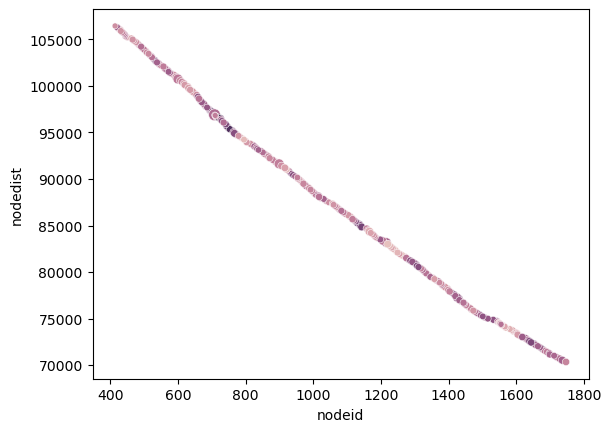

In [40]:
sns.scatterplot(mito_1534008, x='nodeid', y='nodedist', size='count', hue='diams', legend=False)

In [41]:
fig = px.scatter(mito_1534008, 
                    x='nodeid', 
                    y='nodedist',
                    size='count', 
                    color='mitoid_str')
fig.show()

# [Neuroglancer view](https://neuromancer-seung-import.appspot.com/#!%7B%22layers%22:%5B%7B%22source%22:%22precomputed://gs://microns_public_datasets/pinky100_v0/son_of_alignment_v15_rechunked%22%2C%22type%22:%22image%22%2C%22blend%22:%22default%22%2C%22shaderControls%22:%7B%7D%2C%22name%22:%22EM%22%7D%2C%7B%22source%22:%22precomputed://gs://microns_public_datasets/pinky100_v185/seg%22%2C%22type%22:%22segmentation%22%2C%22selectedAlpha%22:0.51%2C%22objectAlpha%22:0.13%2C%22segments%22:%5B%22648518346349537741%22%2C%22648518346349539768%22%5D%2C%22hiddenSegments%22:%5B%22648518346349538235%22%2C%22648518346349539462%22%2C%22648518346349539853%22%5D%2C%22skeletonRendering%22:%7B%22mode2d%22:%22lines_and_points%22%2C%22mode3d%22:%22lines%22%7D%2C%22name%22:%22cell_segmentation_v185%22%7D%2C%7B%22source%22:%22precomputed://matrix://sseung-archive/pinky100-clefts/mip1_d2_1175k%22%2C%22type%22:%22segmentation%22%2C%22skeletonRendering%22:%7B%22mode2d%22:%22lines_and_points%22%2C%22mode3d%22:%22lines%22%7D%2C%22name%22:%22synapses%22%7D%2C%7B%22source%22:%22precomputed://matrix://sseung-archive/pinky100-mito/seg_191220%22%2C%22type%22:%22segmentation%22%2C%22segments%22:%5B%221534008%22%2C%222130887%22%5D%2C%22skeletonRendering%22:%7B%22mode2d%22:%22lines_and_points%22%2C%22mode3d%22:%22lines%22%7D%2C%22name%22:%22mitochondria%22%7D%2C%7B%22source%22:%22precomputed://matrix://sseung-archive/pinky100-nuclei/seg%22%2C%22type%22:%22segmentation%22%2C%22skeletonRendering%22:%7B%22mode2d%22:%22lines_and_points%22%2C%22mode3d%22:%22lines%22%7D%2C%22name%22:%22nuclei%22%7D%5D%2C%22navigation%22:%7B%22pose%22:%7B%22position%22:%7B%22voxelSize%22:%5B4%2C4%2C40%5D%2C%22voxelCoordinates%22:%5B74690.578125%2C40964.40625%2C1162.487060546875%5D%7D%7D%2C%22zoomFactor%22:5.984479141868939%7D%2C%22perspectiveZoom%22:3618.7659948513424%2C%22showSlices%22:false%2C%22selectedLayer%22:%7B%22layer%22:%22mitochondria%22%2C%22visible%22:true%7D%2C%22layout%22:%7B%22type%22:%223d%22%2C%22orthographicProjection%22:true%7D%7D) of mitos 2130887 and 1534008

In [42]:
mito_2718056 = node_metrics_merge[node_metrics_merge.mitoid == 2718056]
mito_2718056

,cellid,mitoid,count,diams,nodedist,nodeid,cellid_str,mitoid_str,surface_area,complexityindex,compartment
0,648518346349539333,2718056,21,0.655340,26594.530396,17670,648518346349539333,2718056,6.903265,21.396764,Basal
1,648518346349539333,2718056,38,0.929892,26869.960938,17708,648518346349539333,2718056,6.903265,21.396764,Basal
2,648518346349539333,2718056,22,0.853151,27009.407959,17725,648518346349539333,2718056,6.903265,21.396764,Basal
3,648518346349539333,2718056,24,0.748397,26464.676453,17653,648518346349539333,2718056,6.903265,21.396764,Basal
4,648518346349539333,2718056,18,0.585603,25934.409683,17576,648518346349539333,2718056,6.903265,21.396764,Basal
...,...,...,...,...,...,...,...,...,...,...,...
62,648518346349539333,2718056,11,0.316919,33676.866753,18633,648518346349539333,2718056,6.903265,21.396764,Basal
63,648518346349539333,2718056,15,0.354685,33917.809563,18664,648518346349539333,2718056,6.903265,21.396764,Basal
64,648518346349539333,2718056,22,0.415182,32925.159584,18503,648518346349539333,2718056,6.903265,21.396764,Basal
65,648518346349539333,2718056,21,0.403593,33075.704445,18516,648518346349539333,2718056,6.903265,21.396764,Basal


<AxesSubplot:xlabel='nodeid', ylabel='nodedist'>

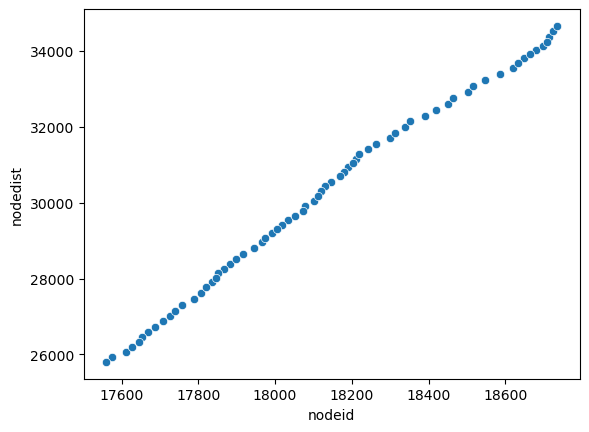

In [43]:
sns.scatterplot(mito_2718056, x='nodeid', y='nodedist')